## CUSTOMER SEGMENTATION

The following notebook explores the ways the customers can be segmented based on the available data.
The main segmentation is performed following the Recency, Frequency, Money approach.

What are you going to find:

1. Traditional RFM:
    - based on quantiles and RFM Score

2. Machine Learning RFM:
    - Exploiting Unsupervised Machine Learning algorithm like K-Means Clustering

3. Kmeans clustering over a more comprehensive set of features

The following libraries are needed in order to run the notebook.

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import plotly.express as px
import plotly.graph_objects as go

The dataset "customer_dataset.csv" is imported, it has been created by combining the relational dataset provided with the use of **Excel**:
- It contains features related to the primary key "customer_unique_id".


In [3]:
df = pd.read_csv("customer_dataset.csv", sep=";", low_memory=False)

The following features are selected to conduct the RFM analysis:

**Recency** : "recency"
**Frequency** : "order_count (only positive orders)"
**Money**: it will be calculated as the sum of the two columns "costoprodotti_totale" and "spedizioni totale".

In [4]:
df_rfm = df[["customer_unique_id", "order_count (only positive orders)", "recency", "costoprodotti_totale", "spedizioni_totale"]]

The syntax for missing values in excel is **#N/D**, so it needs to be replaced with the syntax **NaN**, that can be fixed with Pandas.

In [5]:
df_rfm = df_rfm.replace('#N/D', np.NaN)

In [6]:
df_rfm.apply(lambda x : sum(x.isna()))

customer_unique_id                       0
order_count (only positive orders)    1106
recency                                  0
costoprodotti_totale                   676
spedizioni_totale                      676
dtype: int64

There are 1106 customers without an associated order count.
There are also 676 customers where the cost of the products and of delivery is missing.

In [7]:
df_rfm = df_rfm.dropna(axis=0)

In [8]:
df_rfm.apply(lambda x : sum(x.isna()))

customer_unique_id                    0
order_count (only positive orders)    0
recency                               0
costoprodotti_totale                  0
spedizioni_totale                     0
dtype: int64

The rows containing NaN values are removed, since its not possible to retrieve these missing data from the datasets.

In [9]:
df_rfm.dtypes

customer_unique_id                     object
order_count (only positive orders)     object
recency                               float64
costoprodotti_totale                   object
spedizioni_totale                      object
dtype: object

Checking for the type of values of the feauteres, they need to be transformed to **numeric**.

In [10]:
for column in df_rfm.columns[1:]:
    df_rfm[column] = pd.to_numeric(df_rfm[column])

The column "money" is added to the dataframe, as the sum of "costoprodotti_totale" and "spedizioni tatale"

In [11]:
df_rfm['money']= df_rfm.iloc[:, 3:].sum(axis=1)

The two column used for the sum are deleted, they are not needed anymore.

In [12]:
df_rfm = df_rfm.drop(["costoprodotti_totale", "spedizioni_totale"], axis=1)

### Data visualization of the RFM distribution
To get a sense of the distribution of the three variables is always a good practice to visualize them

In [17]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=3, cols=1,
                    subplot_titles=("Recency distribution", "Frequency distribution", "Money Distribution"))


fig.append_trace(go.Histogram(x=df_rfm.recency,nbinsx=100),
                              row=1, col=1)

count_frequency = df_rfm.groupby("order_count (only positive orders)")["customer_unique_id"].count().to_frame().reset_index()
fig.append_trace(go.Bar(x=count_frequency["order_count (only positive orders)"],
                        y=count_frequency.customer_unique_id,),
                        row=2, col=1)

fig.append_trace(go.Histogram(x=df_rfm.money, nbinsx=150),
                              row=3, col=1)

fig.update_layout(height=1000, width=1000, title_text="RFM features distriubtion")
fig.update_layout(legend_title_text='Features')
fig.show()

By looking at the previous graph it is possible to draw some insights:
- The majority of orders has happened approximately in the last year
- Most users has performed only one order
- Most users has spent between 0 and 200 euros

## Traditional RFM
A traditional RFM analysis exploits the division into quantiles of the features to assign a score to each customer. It is very simple but at the same time very effective in term of segmentation.

A copy of the dataset is used to perform the analysis

In [30]:
df_rfm_traditional = df_rfm.copy()

The column "customer_unqiue_id" is set as index

In [31]:
df_rfm_traditional = df_rfm_traditional.set_index("customer_unique_id")

Create labels for Recency and  Money.
The labels for the recency features have to be in decreasing order, otherwise it would assign a high number to customers with a high recency value.

In [32]:
r_labels = range(4,0,-1); m_labels = [1,2,3,4]

Assign these labels to 4 equal percentile groups, and create the corresponding columns with the score for each customer

In [33]:
r_groups = pd.qcut(df_rfm_traditional['recency'], q=4, labels=r_labels)
m_groups = pd.qcut(df_rfm_traditional['money'], q=4, labels=m_labels)
df_rfm_traditional = df_rfm_traditional.assign(R = r_groups.values, M = m_groups.values)

For the Frequency feature the same procedure can not be followed, through a quantile division there would be only one class due to the high skeweness towards 1 order count as seen in the visualization of its distribution.

So solve the issue it is assigned a value from 1 to 3:
1 = customer performing only one order
2 = customer performing two orders
3 = customer performing at least 3 orders

The column with the score is added to the dataset.

In [34]:
df_rfm_traditional['F'] = df_rfm_traditional['order_count (only positive orders)'].apply(lambda x: 1 if x == 1 else (2 if x==2 else 3))


Visualize the dataset first rows.

In [35]:
df_rfm_traditional.head(1)

,order_count (only positive orders),recency,money,R,M,F
customer_unique_id,,,,,,
861eff4711a542e4b93843c6dd7febb0,1,569.0,146.87,1,3,1


In order to create a "RFM" column a function is defined, perfroming the concatenation of the columns "R", "F", "M"

In [36]:
def join_rfm(x):
    return str(x['R']) + str(x['F']) + str(x['M'])

The function is applied to the dataset assigning the results to a new column "RFM".

In [39]:
df_rfm_traditional['RFM'] = df_rfm_traditional.apply(join_rfm, axis=1)
df_rfm_traditional.head(1)

,order_count (only positive orders),recency,money,R,M,F,RFM
customer_unique_id,,,,,,,
861eff4711a542e4b93843c6dd7febb0,1,569.0,146.87,1,3,1,113


The RFM_Score is calculated as the sum of the individual features. A customer performing very poorly would score 3 points, while the best perfoming custoemrs would score the maximum, 11 points.

In [40]:
df_rfm_traditional['RFM_Score'] = df_rfm_traditional[['R','F','M']].sum(axis=1)
df_rfm_traditional.head(1)

,order_count (only positive orders),recency,money,R,M,F,RFM,RFM_Score
customer_unique_id,,,,,,,,
861eff4711a542e4b93843c6dd7febb0,1,569.0,146.87,1,3,1,113,5


A function is defined to label each customer with an attribute describing its value for the company:

- Can not lose = with a RFM_score higher or equal to 9
- Champions = with a RFM_score of 8
- Loyal = with a RFM_score of 7
- Potential = with a RFM_score of 6
- Promising = with a RFM_score of 5
- Lost = with a RFM_score lower than 5

In [41]:
def rfm_level(df):
    if df['RFM_Score'] >= 9:
        return 'Can not lose'
    elif (df['RFM_Score'] >= 8) and (df['RFM_Score'] <9):
        return 'Champions'
    elif (df['RFM_Score'] >= 7) and (df['RFM_Score'] < 8):
        return 'Loyal'
    elif (df['RFM_Score'] >= 6) and (df['RFM_Score'] < 7):
        return 'Potential'
    elif (df['RFM_Score'] >= 5) and (df['RFM_Score'] < 6):
        return 'Promising'
    else:
        return 'Lost'

The function is applied to the dataset, and a new column id created, assigning to each customer its level.

In [42]:
df_rfm_traditional['RFM_Level'] = df_rfm_traditional.apply(rfm_level, axis=1)
df_rfm_traditional.head(5)

,order_count (only positive orders),recency,money,R,M,F,RFM,RFM_Score,RFM_Level
customer_unique_id,,,,,,,,,
861eff4711a542e4b93843c6dd7febb0,1,569.0,146.87,1,3,1,113,5,Promising
290c77bc529b7ac935b93aa66c333dc3,1,328.0,335.48,2,4,1,214,7,Loyal
060e732b5b29e8181a18229c7b0b2b5e,1,201.0,157.73,4,3,1,413,8,Champions
259dac757896d24d7702b9acbbff3f3c,1,268.0,173.30,3,3,1,313,7,Loyal
345ecd01c38d18a9036ed96c73b8d066,1,130.0,252.25,4,4,1,414,9,Can not lose


Lastly, to the previous dataset it is added the number of customers for each cluster ("count") and the amount of money spent for each cluster ("money_cluster")

In [43]:
RFM = df_rfm_traditional.groupby(['RFM_Level']).mean()
RFM = pd.DataFrame(RFM)
RFM["count"] = df_rfm_traditional.RFM_Level.value_counts()
RFM["money_cluster"] = RFM["money"] * RFM["count"]
RFM = RFM.reset_index()
RFM

,RFM_Level,order_count (only positive orders),recency,money,F,RFM_Score,count,money_cluster
0,Can not lose,1.183086,170.712364,399.216443,1.170658,9.050925,6598,2634030.09
1,Champions,1.073452,219.537426,260.396004,1.072807,8.000000,12389,3226046.09
2,Lost,1.000951,495.113348,57.258803,1.000951,3.663200,17883,1023959.18
3,Loyal,1.045426,273.781407,203.813313,1.045201,7.000000,17743,3616259.62
4,Potential,1.012759,335.730391,162.725081,1.012716,6.000000,23042,3749511.32
5,Promising,1.005849,396.461779,87.612286,1.005849,5.000000,17438,1527783.04


## RFM - K-MEANS
After the traditional method a method that exploit unsupervised learning algorithm is used. Its results will be confronted with the traditional method

Copy of the initial dataset for the RFM analysis

In [46]:
df_segmentation = df_rfm.copy()

In [47]:
df_segmentation = df_segmentation.drop(['customer_unique_id'], axis=1)

The column "customer_unique_id" is dropped

In [48]:
df_seg_scale = df_segmentation.copy()
scaler = StandardScaler()
df_seg_scale= scaler.fit_transform(df_seg_scale)

A new dataset to perform the scaling is created. It is than scaled with the function "StandardScaler()" from the Sklearn package.

To find the optimal division the "Elbow method" is used. By iterating over the results of the clustering of the data points, it is possible to select the partition that minimized the Within Sums of Squares (y-axis).

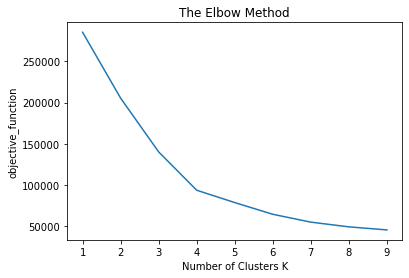

In [66]:
objective_function = []
for i in range(1, 10):
    clustering = KMeans(n_clusters=i, init='k-means++')
    clustering.fit(df_seg_scale)
    objective_function.append(clustering.inertia_)
plt.plot(range(1, 10), objective_function)
plt.title('The Elbow Method')
plt.xlabel('Number of Clusters K')
plt.ylabel('objective_function')
plt.show()

By visualizing the linegraph, a cluster of 6 is selected.

In [49]:
kmeans = KMeans(n_clusters=6, init='k-means++', random_state = 0)
y_kmeans = kmeans.fit_predict(df_seg_scale)

A column with the result of the clustering classification is added to the initial dataset (not scaled)

In [50]:
df_segmentation['cluster_kmeans'] = y_kmeans

A new dataset is created, containing the Mean of each features for each of the six clusters, the number of customers for each cluster and the money spent in total by each cluster.

In [51]:
RFM_kmeans = df_segmentation.groupby(['cluster_kmeans']).mean()
RFM_kmeans = pd.DataFrame(RFM_kmeans)
RFM_kmeans["count"] = df_segmentation.cluster_kmeans.value_counts()
RFM_kmeans["money_cluster"] = RFM_kmeans["money"] * RFM_kmeans["count"]
RFM_kmeans

,order_count (only positive orders),recency,money,count,money_cluster
cluster_kmeans,,,,,
0,1.000000,354.629931,120.604758,32956,3974650.40
1,1.000000,326.112794,711.496634,4192,2982593.89
2,2.113131,364.674975,290.460458,2970,862667.56
3,1.000000,186.161108,125.421349,33611,4215536.95
4,1.000000,558.428585,126.712883,20836,2640189.64
5,1.058712,336.387311,2087.028220,528,1101950.90


### Cluster 3D Visualization

To visualize the clusters, the column "cluster" is added to the scaled dataframe.

In [52]:
df_seg_scale= pd.DataFrame(df_seg_scale)
df_seg_scale["cluster"] = y_kmeans

Implementing the Plotly library, and in particular the "scatter_3d" function,  it is possible to easily visualize the results of the clustering process.
The plot is displayed in a browser page.

In [53]:
fig = px.scatter_3d(df_seg_scale,
                 x=0,
                 y=1,
                 z=2,
                 size_max=0.1,
                 color="cluster", opacity=0.8)
fig.update_traces(marker=dict(size=3))
fig.show()

## K-Means over more features - Going Forward
Clustering with additional features other than the RFM.

By considering also additional feature it might be possible to better understand the characteristic and behaviours of the customers of the e-commerce.

A subset of features is selected from the initial dataset:

customer_unique_id: the unique ID that identifies a customer
product_count = the number of product each customer purchases
costoprodotti_totale = how much every customer has spent
spedizioni_total = how much each customer has spent for the delivery
n_medio_pagamenti = the number of payments the customers performs for the purchase
n_medio_rate = the average number of installments the customer performs in relation to its orders
order_count (only positive orders) = the number of orders for each customer
recency = the time between the last purchase of the customer and the last purchase present in the dataset.

The #N/D values are than transformed into NaN values and the rows dropped.

In [75]:
df_start = df[["customer_unique_id","product count", "costoprodotti_totale",
               "spedizioni_totale", "n_medio_pagamenti", "n_medio_rate",
               "order_count (only positive orders)", "recency"]]
df_start = df_start.replace('#N/D', np.NaN)
df_start = df_start.dropna(axis=0)
df_start.apply(lambda x : sum(x.isna()))

customer_unique_id                    0
product count                         0
costoprodotti_totale                  0
spedizioni_totale                     0
n_medio_pagamenti                     0
n_medio_rate                          0
order_count (only positive orders)    0
recency                               0
dtype: int64

The features as transformed into numeric type

In [76]:
for column in df_start.columns[1:]:
    df_start[column] = pd.to_numeric(df_start[column])

The column "money" is added as the sum of the "costoprodotti_totale" and "spedizioni_totale". The latter columns are than dropped form the dataset

In [77]:
df_start['money']= df_start.iloc[:, 2:4].sum(axis=1)

In [78]:
df_start = df_start.drop(["costoprodotti_totale", "spedizioni_totale"], axis=1)

The dataset "df_seg" is created by dropping the "customer_unique_id" column

In [79]:
df_seg = df_start.drop(['customer_unique_id'], axis=1)

The feature are Standardized

In [80]:
df_scale = df_seg.copy()
scaler = StandardScaler()
df_scale= scaler.fit_transform(df_scale)

To decide how many cluster to chose, the elbow method is implemented as seen in the previous k-means implementation.

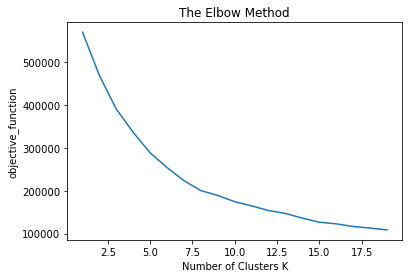

In [81]:
objective_function = []
for i in range(1, 20):
    clustering = KMeans(n_clusters=i, init='k-means++')
    clustering.fit(df_scale)
    objective_function.append(clustering.inertia_)
plt.plot(range(1, 20), objective_function)
plt.title('The Elbow Method')
plt.xlabel('Number of Clusters K')
plt.ylabel('objective_function')
plt.show()

Seven cluster are selected.

In [82]:
kmeans = KMeans(n_clusters=7, init='k-means++', random_state = 42)
y_kmeans = kmeans.fit_predict(df_scale)

The column "cluster_kmeans",containing the cluster for each customer, is added to the "df_seg" dataset.
It is than calculated the mean value for each feature in relation to each cluster, the count values (how many customer for each cluster) and the money_cluster column, indicating the total money spent by the cluster.

In [164]:
df_seg['cluster_kmeans'] = y_kmeans
kmeans_large = df_seg.groupby(['cluster_kmeans']).mean()
kmeans_large = pd.DataFrame(kmeans_large)
kmeans_large["count"] = df_seg.cluster_kmeans.value_counts()
kmeans_large["money_cluster"] = kmeans_large["money"] * kmeans_large["count"]
kmeans_large

,product count,n_medio_pagamenti,n_medio_rate,order_count (only positive orders),recency,money,count,money_cluster
cluster_kmeans,,,,,,,,
0,1.069098,1.016355,1.780713,1.000000,227.717062,118.043422,43605,5147283.42
1,2.457045,1.027150,3.257734,2.115464,364.800118,285.286216,2910,830182.89
2,1.204785,1.021933,6.526859,1.015482,334.561342,1430.652730,1421,2032957.53
3,1.112198,1.003965,7.838953,1.000000,341.295453,242.615328,14207,3446835.97
4,3.953141,1.009305,3.692589,1.028913,335.965271,342.451142,2006,686956.99
5,1.176245,3.608067,1.058894,1.042146,376.665390,152.559923,261,39818.14
6,1.071606,1.020082,1.972128,1.000000,492.764161,117.117885,30682,3593410.94
